# Визуализация графика лосса и работы модели

## Визуализация графика лосса

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [2]:
loss_history = np.loadtxt('train_losses.txt')
mse_history = np.loadtxt('train_mses.txt')
val_mses = np.loadtxt('validation_mses.txt')
n_epochs = len(val_mses)

In [3]:
epoch_len = len(loss_history) // n_epochs

In [4]:
def running_mean(X, n):
    cumsum = np.cumsum(X)
    return (cumsum[n:] - cumsum[:-n]) / n

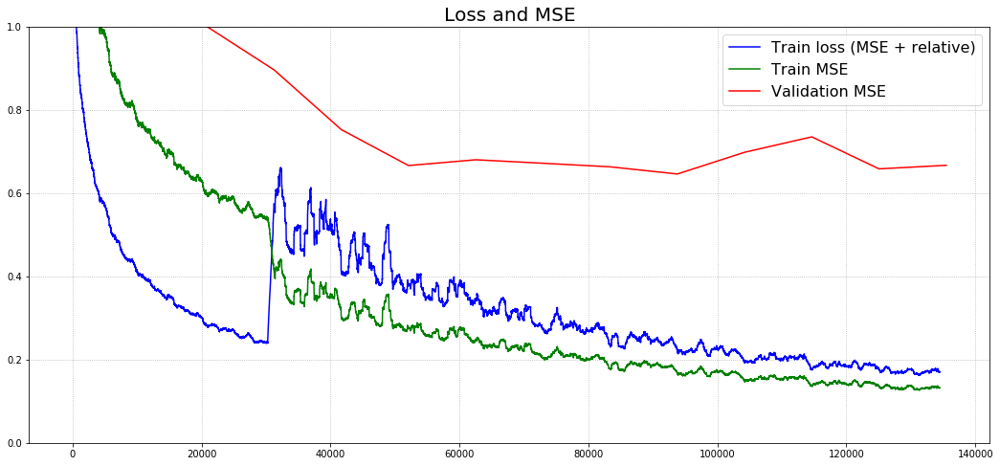

In [5]:
plt.figure(figsize=(18, 8))
plt.title('Loss and MSE', fontsize=20)
plt.grid(ls=':')
plt.plot(running_mean(loss_history, 1000), color='b', label='Train loss (MSE + relative)')
plt.plot(running_mean(mse_history, 1000), color='g', label='Train MSE')
plt.plot(np.arange(epoch_len, len(loss_history) + epoch_len, epoch_len),
         val_mses, color='r', label='Validation MSE')
plt.ylim((0, 1))
plt.legend(fontsize=16)

## Загрузка датасета

In [6]:
import h5py
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = np.array(val_data_file['data'])
depths_val = np.array(val_data_file['label'])

In [7]:
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = np.array(test_data_file['data'])
depths_test = np.array(test_data_file['label'])

### Создание модели

In [8]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [9]:
import sys
sys.path.append('/home/kmouraviev')

In [10]:
from tensorflow_resnet.my_batch_normalization import MyBatchNormalization

Using TensorFlow backend.


In [15]:
import tensorflow as tf

In [16]:
def interleave(tensors, axis):
    old_shape = tensors[0].get_shape().as_list()[1:]
    new_shape = [-1] + old_shape
    new_shape[axis] *= len(tensors)
    return tf.reshape(tf.stack(tensors, axis + 1), new_shape)

def interleave_four(tensors):
    in1, in2, in3, in4 = tensors
    inter_12 = interleave([in1, in2], axis=1)
    inter_34 = interleave([in3, in4], axis=1)
    inter = interleave([inter_12, inter_34], axis=2)
    return inter

In [17]:
from keras.models import load_model
model = load_model('model_on_epoch9.hdf5',
                   custom_objects={'MyBatchNormalization': MyBatchNormalization,
                                   'interleave': interleave,
                                   'interleave_four': interleave_four})

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


In [18]:
val_prediction = model.predict(rgbs_val, batch_size=16)
mse = np.mean((val_prediction - depths_val) ** 2)
print('MSE on different scenes:', mse)
rel_error = np.mean(np.abs(val_prediction - depths_val) / np.maximum(depths_val, 0.5))
print('Relative error on different scenes:', rel_error)

MSE on different scenes: 0.6584371032138256
Relative error on different scenes: 0.2325112100448128


In [19]:
val_prediction = np.maximum(val_prediction, 0.5)
depths_val = np.maximum(depths_val, 0.5)
rel_error = np.maximum(val_prediction / depths_val, depths_val / val_prediction)
print('val delta_1:', np.mean(rel_error < 1.25))
print('val delta_2:', np.mean(rel_error < 1.25 ** 2))
print('val delta_3:', np.mean(rel_error < 1.25 ** 3))

val delta_1: 0.6417094400494036
val delta_2: 0.8861223184548225
val delta_3: 0.9642076808284659


### Калибровка

In [20]:
from tqdm import tqdm_notebook

In [21]:
target_predicted_depths = np.arange(val_prediction.min() - 0.001, val_prediction.max(), 0.1)
mean_real_depths = []
for depth in tqdm_notebook(target_predicted_depths):
    target_pixels = np.logical_and(val_prediction > depth, val_prediction < depth + 0.1)
    mean_real_depth = np.mean(depths_val[target_pixels]).mean()
    mean_real_depths.append(mean_real_depth)

Text(0.5, 0, 'Mean real depth')

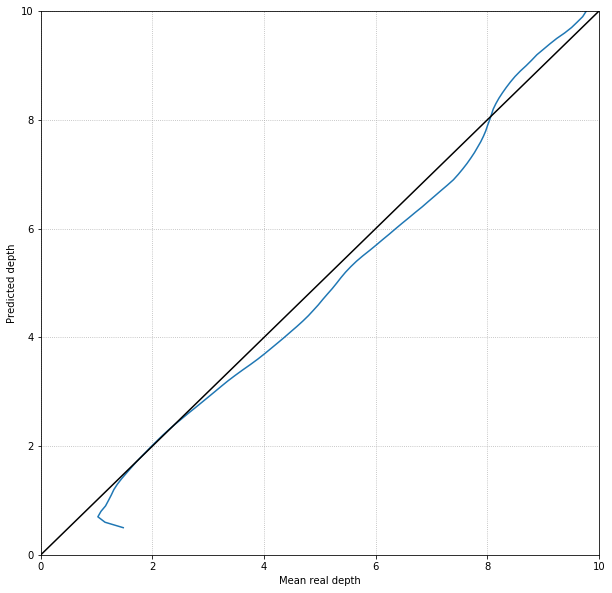

In [22]:
plt.figure(figsize=(10, 10))
plt.plot(mean_real_depths, target_predicted_depths)
plt.plot([0, 10], [0, 10], color='black')
plt.grid(ls=':')
plt.xlim((0, 10))
plt.ylim((0, 10))
plt.ylabel('Predicted depth')
plt.xlabel('Mean real depth')

Text(0, 0.5, 'Mean depth ratio')

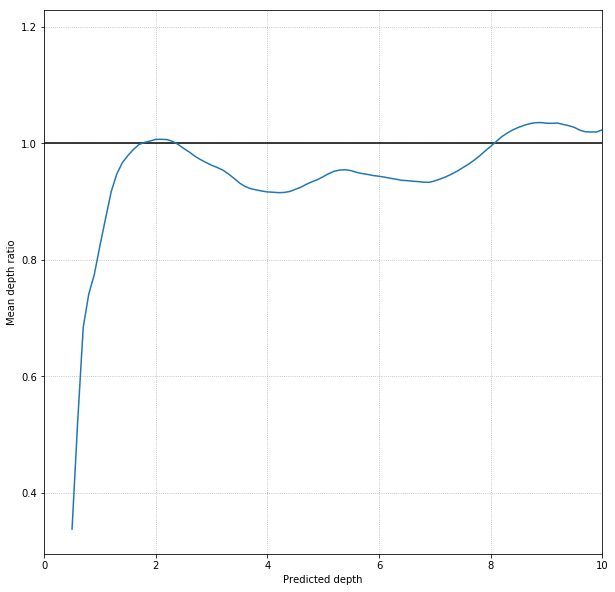

In [23]:
plt.figure(figsize=(10, 10))
plt.plot(target_predicted_depths, target_predicted_depths / mean_real_depths)
plt.hlines(1, 0, 10)
plt.grid(ls=':')
plt.xlim((0, 10))
plt.xlabel('Predicted depth')
plt.ylabel('Mean depth ratio')

In [24]:
corrected_prediction = val_prediction.copy()
for i in tqdm_notebook(range(25, 75)):
    target_pixels = np.logical_and(val_prediction > target_predicted_depths[i], 
                                   val_prediction < target_predicted_depths[i + 1])
    corrected_prediction[target_pixels] *= mean_real_depths[i] / target_predicted_depths[i]

In [25]:
print('With corrected prediction:')
mse = np.mean((corrected_prediction - depths_val) ** 2)
print('MSE on different scenes:', mse)
rel_error = np.mean(np.abs(corrected_prediction - depths_val) / np.maximum(depths_val, 0.5))
print('Relative error on different scenes:', rel_error)

With corrected prediction:
MSE on different scenes: 0.639269454855139
Relative error on different scenes: 0.23526297319258768


In [26]:
rel_error = np.maximum(corrected_prediction / depths_val, depths_val / corrected_prediction)
print('val delta_1:', np.mean(rel_error < 1.25))
print('val delta_2:', np.mean(rel_error < 1.25 ** 2))
print('val delta_3:', np.mean(rel_error < 1.25 ** 3))

val delta_1: 0.6474024996678848
val delta_2: 0.8865317964983898
val delta_3: 0.9634855698133118


### Визуализация

In [27]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


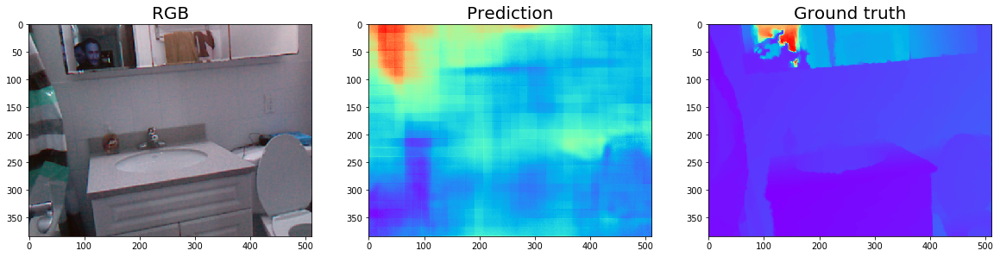

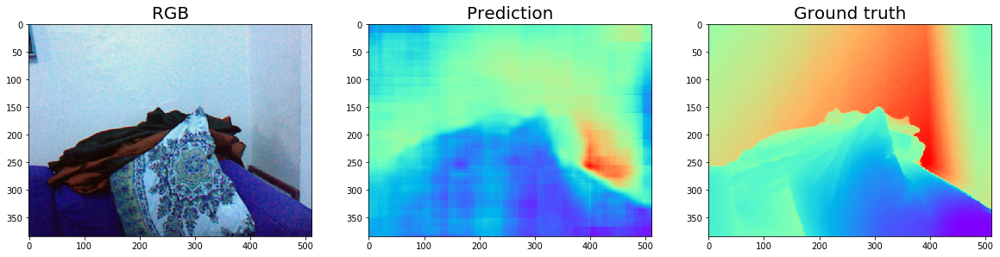

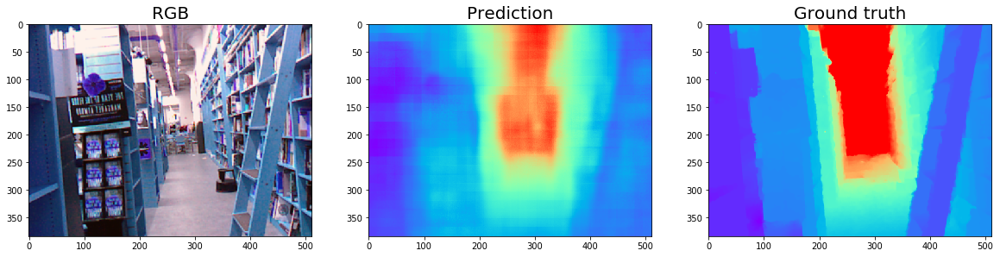

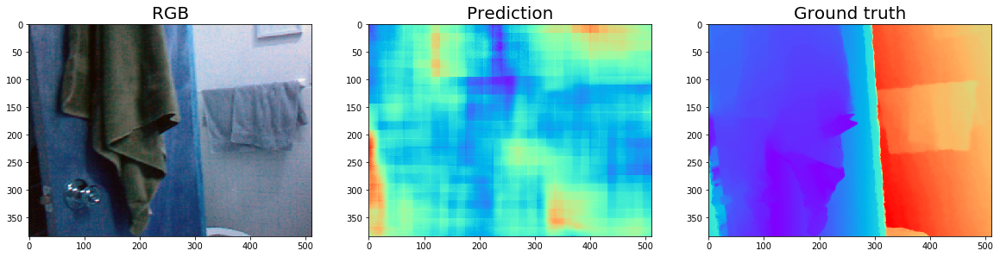

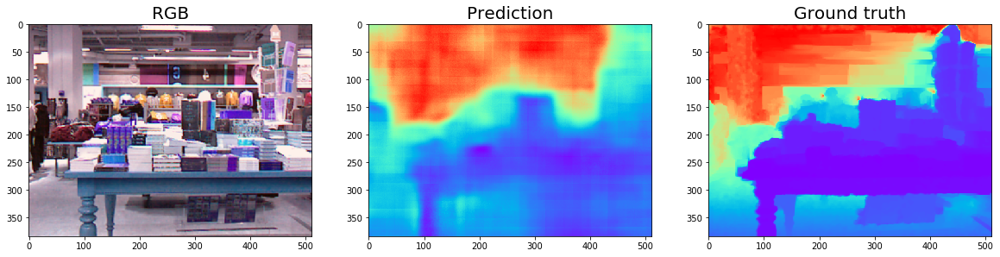

...

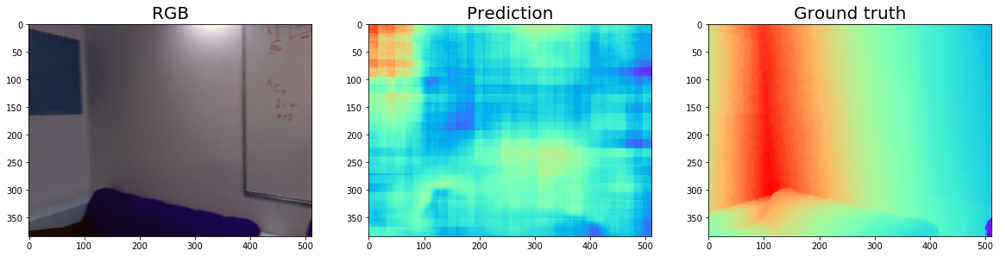

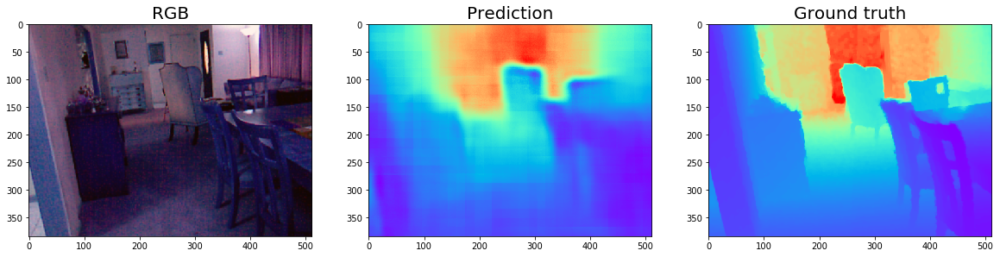

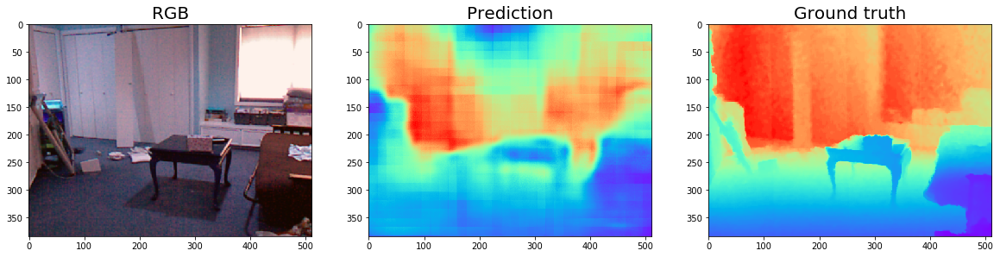

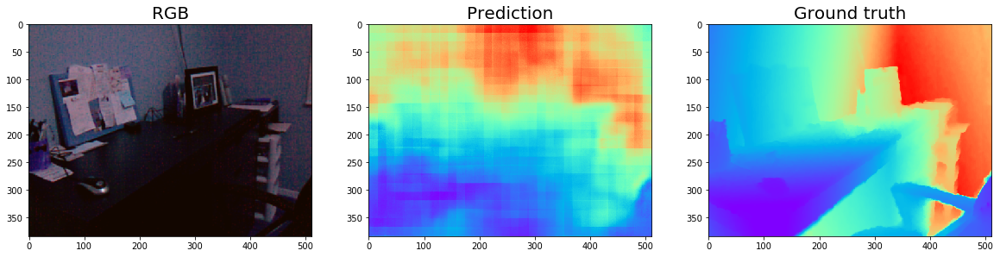

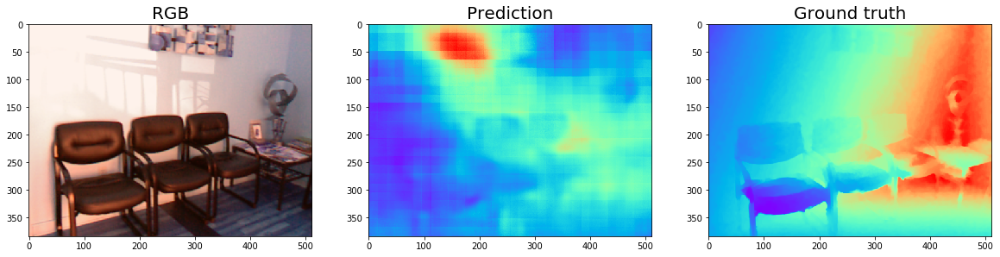

In [28]:
rgbs_val_sample = rgbs_val[::534]
depths_val_sample = depths_val[::534]
val_prediction_sample = model.predict(rgbs_val_sample)
for i in range(len(rgbs_val_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(val_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

In [29]:
error = (val_prediction - depths_val) ** 2
relative_error = np.abs(val_prediction - depths_val) / np.maximum(depths_val, 0.5)
target_pixels = (depths_val < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 1, depths_val < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 2, depths_val < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_val > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.710415008551596
Relative_error: 0.7965755451113419


On objects with depth between 1m and 2m:
MSE: 0.33438018574830747
Relative_error: 0.2757711339996371


On objects with depth between 2m and 5m:
MSE: 0.47480109636120155
Relative_error: 0.1598964242466925


On objects with depth > 5m:
MSE: 2.5900208008587873
Relative_error: 0.19474165634047208




In [30]:
error = (val_prediction - depths_val) ** 2
np.mean(error)

0.6571771282903489

In [31]:
corrected_error = (corrected_prediction - depths_val) ** 2
np.mean(corrected_error)

0.639269454855139

In [32]:
print('With corrected prediction:')
error = (corrected_prediction - depths_val) ** 2
relative_error = np.abs(corrected_prediction - depths_val) / np.maximum(depths_val, 0.5)
target_pixels = (depths_val < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 1, depths_val < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 2, depths_val < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_val > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

With corrected prediction:
On objects with depth < 1m:
MSE: 0.7258134517664382
Relative_error: 0.799364282884363


On objects with depth between 1m and 2m:
MSE: 0.36279236800184994
Relative_error: 0.27970019193239065


On objects with depth between 2m and 5m:
MSE: 0.5322851702433541
Relative_error: 0.16937676067303115


On objects with depth > 5m:
MSE: 2.0524106418839003
Relative_error: 0.1655583541768688




### Валидационная выборка: другие коллекции

In [33]:
test_prediction = model.predict(rgbs_test, batch_size=16)
mse = np.mean((test_prediction - depths_test) ** 2)
print('MSE on different collections:', mse)
rel_error = np.mean(np.abs(test_prediction - depths_test) / np.maximum(depths_test, 0.5))
print('Relative error on different scenes:', rel_error)

MSE on different collections: 0.921963526412525
Relative error on different scenes: 0.270887896832013


In [34]:
test_prediction = np.maximum(test_prediction, 0.5)
depths_test = np.maximum(depths_test, 0.5)
rel_error = np.maximum(test_prediction / depths_test, depths_test / test_prediction)
print('Test delta_1:', np.mean(rel_error < 1.25))
print('Test delta_2:', np.mean(rel_error < 1.25 ** 2))
print('Test delta_3:', np.mean(rel_error < 1.25 ** 3))

Test delta_1: 0.5833833373821106
Test delta_2: 0.8413124207602551
Test delta_3: 0.9390633529906683


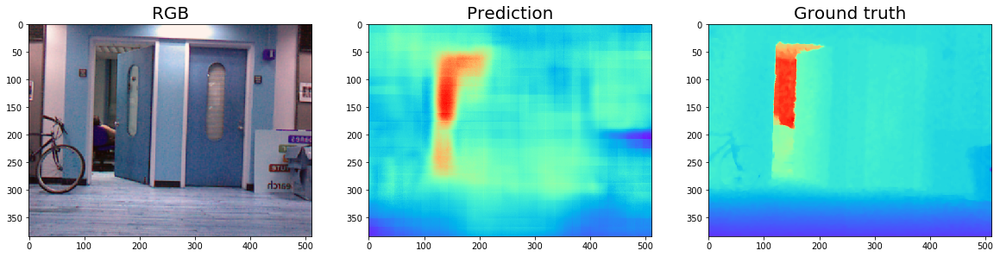

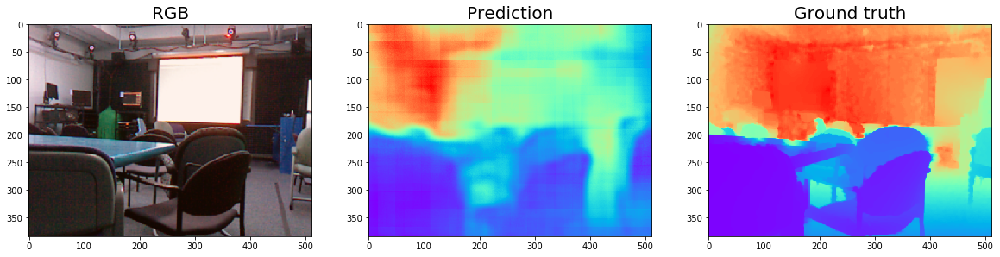

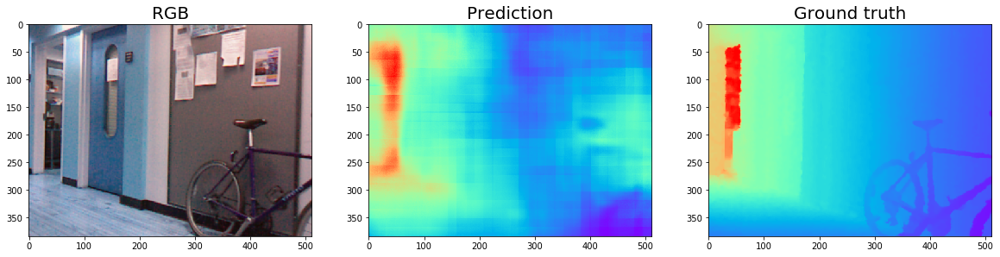

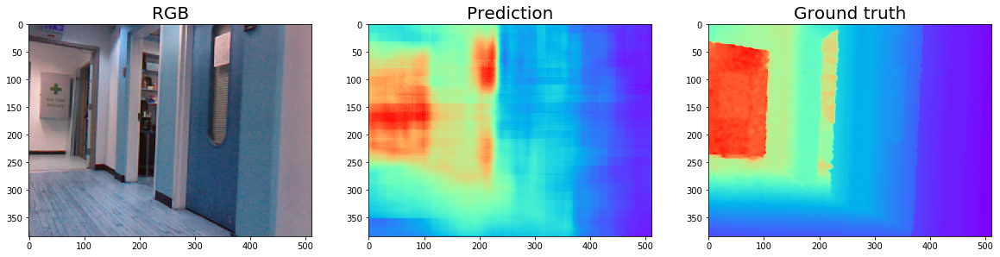

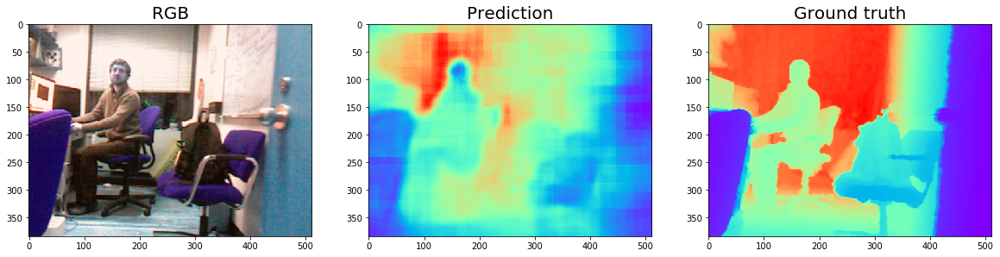

...

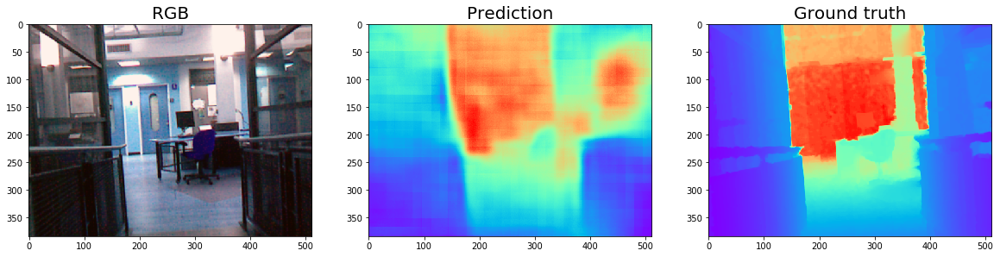

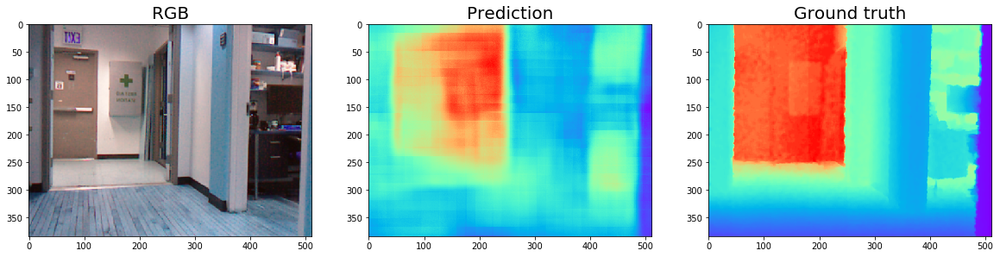

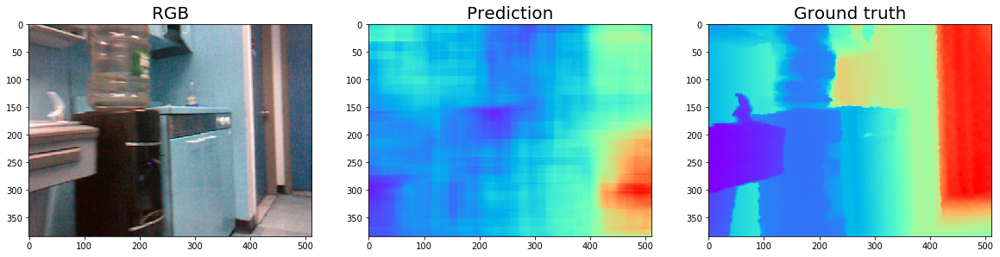

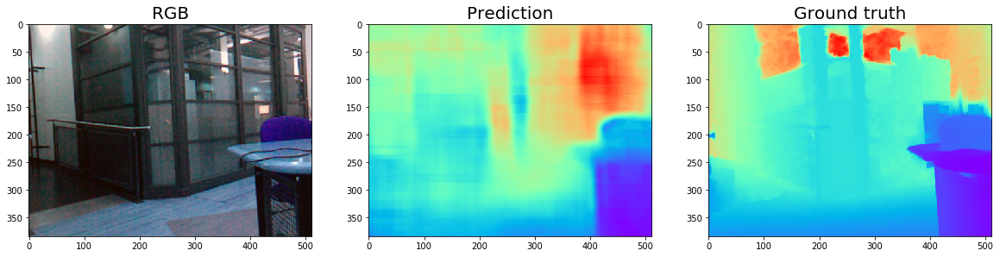

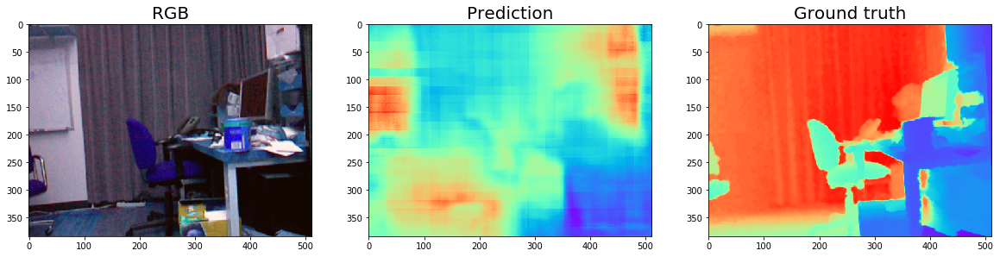

In [35]:
rgbs_test_sample = rgbs_test[::128]
depths_test_sample = depths_test[::128]
test_prediction_sample = model.predict(rgbs_test_sample)
for i in range(len(rgbs_test_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(test_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')

In [36]:
error = (test_prediction - depths_test) ** 2
relative_error = np.abs(test_prediction - depths_test) / np.maximum(depths_test, 0.5)
target_pixels = (depths_test < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 1, depths_test < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 2, depths_test < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_test > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.7999005990209692
Relative_error: 0.930403784209007


On objects with depth between 1m and 2m:
MSE: 0.4899739701913709
Relative_error: 0.36864257408443474


On objects with depth between 2m and 5m:
MSE: 0.5316333352412627
Relative_error: 0.1790180100083268


On objects with depth > 5m:
MSE: 3.372831675901414
Relative_error: 0.2108113749893315


